<a href="https://colab.research.google.com/github/stayploy/gbm.simulation.for.stock/blob/main/GBM_simulation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

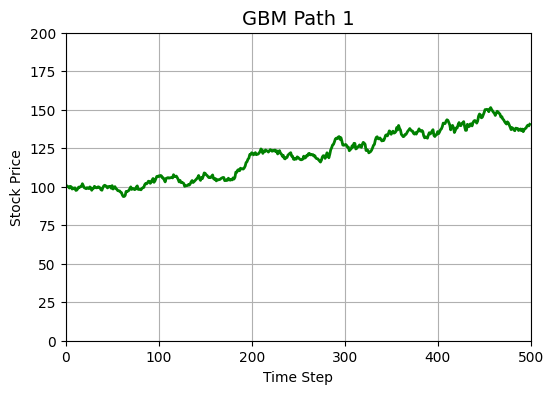

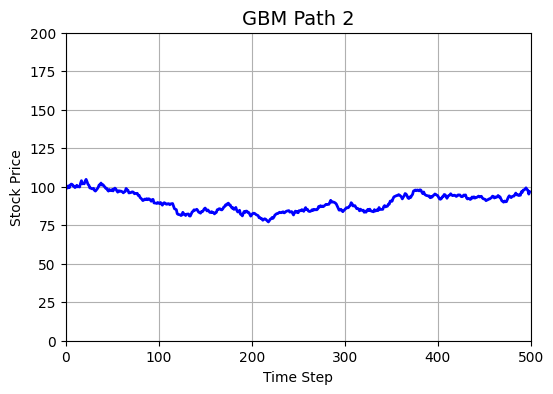

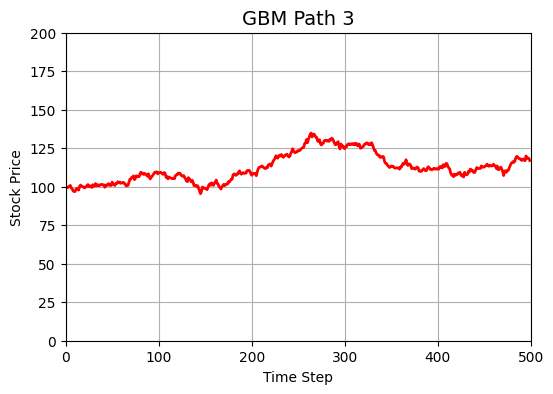

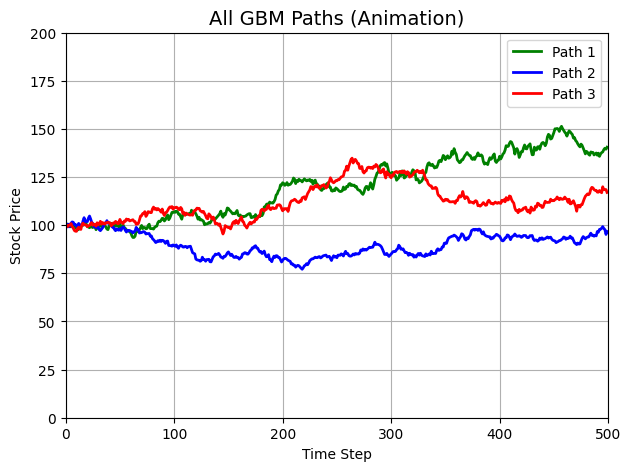

In [10]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

from matplotlib import rcParams
rcParams['animation.html'] = 'jshtml'
rcParams['animation.embed_limit'] = 200.0


# --- Parameters ---
N = 500
S0 = 100
mu = 0.00005
sigma = 0.01
dt = 1
n_paths = 3

# --- Equation ---
S = np.zeros((n_paths, N))
S[:, 0] = S0

for i in range(n_paths):
    for k in range(1, N):
        R = mu * dt + sigma * np.sqrt(dt) * np.random.randn()
        S[i, k] = S[i, k-1] + S[i, k-1] * R

# --- Colors for each line ---
colors = ['green', 'blue', 'red']

# --- Graph ---
for i in range(3):
    plt.figure(figsize=(6, 4))
    plt.plot(S[i], color=colors[i], lw=2)
    plt.title(f'GBM Path {i+1}', fontsize=14)
    plt.xlabel('Time Step')
    plt.ylabel('Stock Price')
    plt.ylim(0, 200)
    plt.xlim(0, N)
    plt.grid(True)
    plt.show()

# --- animation ---
fig, ax = plt.subplots(figsize=(7, 5))
lines = []
for i in range(3):
    line, = ax.plot([], [], lw=2, color=colors[i], label=f'Path {i+1}')
    lines.append(line)

ax.set_xlim(0, N)
ax.set_ylim(0, 200)
ax.set_xlabel('Time Step')
ax.set_ylabel('Stock Price')
ax.set_title('All GBM Paths (Animation)', fontsize=14)
ax.legend()
ax.grid(True)

def init():
    for line in lines:
        line.set_data([], [])
    return lines

def update(frame):
    x = np.arange(frame)
    for i in range(3):
        y = S[i, :frame]
        lines[i].set_data(x, y)
    return lines

ani = FuncAnimation(fig, update, frames=range(1, N+1),
                    init_func=init, blit=True, interval=20, repeat=False)

HTML(ani.to_jshtml())